# Importing the required libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Loading the dataset to the pandas dataframe.

In [2]:
df = pd.read_csv('https://raw.githubusercontent.com/santhoshsai3/CMPE255-TermProject/main/ratings_Beauty.csv')


# Summary of Dataset

In [3]:
print("shape of the dataset :" , df.shape)
(rows,cols) = df.shape
print("The number of rows : ", rows)
print("The number of columns : ", cols)

shape of the dataset : (2023070, 4)
The number of rows :  2023070
The number of columns :  4


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2023070 entries, 0 to 2023069
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   UserId     object 
 1   ProductId  object 
 2   Rating     float64
 3   Timestamp  int64  
dtypes: float64(1), int64(1), object(2)
memory usage: 61.7+ MB


In [5]:
df.describe()

,Rating,Timestamp
count,2.023070e+06,2.023070e+06
mean,4.149036e+00,1.360389e+09
std,1.311505e+00,4.611860e+07
min,1.000000e+00,9.087552e+08
25%,4.000000e+00,1.350259e+09
50%,5.000000e+00,1.372810e+09
75%,5.000000e+00,1.391472e+09
max,5.000000e+00,1.406074e+09


In [6]:
#displaying the dataset
df

,UserId,ProductId,Rating,Timestamp
0,A39HTATAQ9V7YF,0205616461,5.0,1369699200
1,A3JM6GV9MNOF9X,0558925278,3.0,1355443200
2,A1Z513UWSAAO0F,0558925278,5.0,1404691200
3,A1WMRR494NWEWV,0733001998,4.0,1382572800
4,A3IAAVS479H7M7,0737104473,1.0,1274227200
...,...,...,...,...
2023065,A3DEHKPFANB8VA,B00LORWRJA,5.0,1405296000
2023066,A3DEHKPFANB8VA,B00LOS7MEE,5.0,1405296000
2023067,AG9TJLJUN5OM3,B00LP2YB8E,5.0,1405382400
2023068,AYBIB14QOI9PC,B00LPVG6V0,5.0,1405555200


In [7]:
#checking for the data integriety by finding the duplicate rows.
duplicates = df.duplicated(["UserId","ProductId", "Rating", "Timestamp"]).sum()
print(' Duplicate records: ',duplicates)

 Duplicate records:  0


In [8]:
#Printing the number of unique users
print('unique users:',len(df['UserId'].unique()))



unique users: 1210271


In [9]:
#Printing the number of unique products
print('unique products:',len(df['ProductId'].unique()))


unique products: 249274


In [10]:
#Printing the number of unique ratings
print('unique ratings:',len(df['Rating'].unique()))

unique ratings: 5


# Handling null values

In [11]:
df.isnull().any()

UserId       False
ProductId    False
Rating       False
Timestamp    False
dtype: bool

#Data Analysis

In [12]:
#Number of rated products per user

prod_per_user= df.groupby(by = "UserId")["Rating"].count().sort_values(ascending =False)
prod_per_user.head()

UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
Name: Rating, dtype: int64

In [13]:
#Number of ratings per product

product_rating = df.groupby(by = "ProductId")["Rating"].count().sort_values(ascending = False)
product_rating.head()

ProductId
B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
Name: Rating, dtype: int64

In [14]:
#Number of products rated by each user

rated_users=df.groupby("UserId")["ProductId"].count().sort_values(ascending=False)
print(rated_users)

UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
                 ... 
A2G8M8PDTN09UZ      1
A2G8MAFIIQSJ42      1
A2G8MTKRE6MV52      1
A2G8MWBXG6JIY6      1
AZZZU2TD7Q3ET       1
Name: ProductId, Length: 1210271, dtype: int64


In [15]:
#Number of users who rated each product

rated_products=df.groupby("ProductId")["UserId"].count().sort_values(ascending=False)
print(rated_products)

ProductId
B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
              ... 
B004U81OBC       1
B004U7R0EI       1
B004U7Q2O2       1
B004U7NKRE       1
B00LU0LTOU       1
Name: UserId, Length: 249274, dtype: int64


In [16]:
#Number of products with some minimum ratings

print('Number of products with minimum of 5 reviews/ratings:',rated_products[rated_products>5].count())
print('Number of products with minimum of 4 reviews/ratings:',rated_products[rated_products>4].count())
print('Number of products with minimum of 3 reviews/ratings:',rated_products[rated_products>3].count())
print('Number of products with minimum of 2 reviews/ratings:',rated_products[rated_products>2].count())
print('Number of products with minimum of 1 reviews/ratings:',rated_products[rated_products>1].count())

Number of products with minimum of 5 reviews/ratings: 57722
Number of products with minimum of 4 reviews/ratings: 67345
Number of products with minimum of 3 reviews/ratings: 81247
Number of products with minimum of 2 reviews/ratings: 103581
Number of products with minimum of 1 reviews/ratings: 145790


# Data Visualization

In [17]:
!pip install plotly==5.7.0
import plotly.graph_objects as go
index = ['Total size of records', "Number of unique users","Number of unique products"]
values =[len(df),len(df['UserId'].unique()),len(df['ProductId'].unique())]

plot = go.Figure([go.Bar(x=index, y=values,textposition='auto')])
plot.update_layout(title_text='Number of Users and Products w.r.to Total size of Data',
                    xaxis_title="Records",
                    yaxis_title="Total number of Records")

plot.show()
#This plot shows the total records in the dataset and the unique users and products

You should consider upgrading via the '/Library/Frameworks/Python.framework/Versions/3.10/bin/python3.10 -m pip install --upgrade pip' command.


In [18]:
print("Range of Ratings: ", df['Rating'].value_counts())
print(list(df['Rating'].value_counts()))

values = list(df['Rating'].value_counts())

plot = go.Figure([go.Bar(x = df['Rating'].value_counts().index, y = values,textposition='auto')])

plot.update_layout(title_text='Ratings given by user',
                    xaxis_title="Rating",
                    yaxis_title="Total number of Ratings")

plot.show()
#This plot shows the frequency of each different rating. 


Range of Ratings:  5.0    1248721
4.0     307740
1.0     183784
3.0     169791
2.0     113034
Name: Rating, dtype: int64
[1248721, 307740, 183784, 169791, 113034]


In [19]:
print("Products with occurred the most: \n",df['ProductId'].value_counts().nlargest(5))

values = list(df['ProductId'].value_counts())


plot = go.Figure([go.Bar(x = df['ProductId'].value_counts().nlargest(5).index, y = values,textposition='auto')])

plot.update_layout(title_text='Most rated products',
                    xaxis_title="ProductID",
                    yaxis_title="Number of times occurred in the data")

plot.show()

#This plot shows the popular products and the ratings given to them.

Products with occurred the most: 
 B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
Name: ProductId, dtype: int64


In [20]:
ratings_per_user = df.groupby('UserId')['Rating'].count().sort_values(ascending=False)
print("Average rating given by each user: ",ratings_per_user.head())

plot = go.Figure(data=[go.Histogram(x=ratings_per_user)])
plot.show()


Average rating given by each user:  UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
Name: Rating, dtype: int64


In [21]:
ratings_per_product = df.groupby('ProductId')['Rating'].count().sort_values(ascending=False)
# print("Average rating given by each user: ",ratings_per_user.head())

plot = go.Figure(data=[go.Histogram(x=ratings_per_product)])
plot.show(title_text='Number of ratings per product',
                    xaxis_title="Product",
                    yaxis_title="Number of ratings")

array([[<AxesSubplot:xlabel='Rating', ylabel='Rating'>,
        <AxesSubplot:xlabel='Timestamp', ylabel='Rating'>],
       [<AxesSubplot:xlabel='Rating', ylabel='Timestamp'>,
        <AxesSubplot:xlabel='Timestamp', ylabel='Timestamp'>]],
      dtype=object)

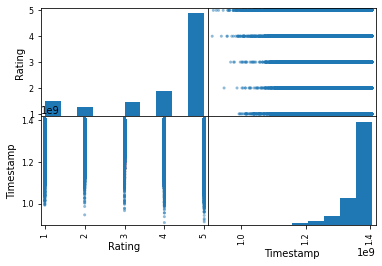

In [22]:
#plotScatterMatrix(df, 6, 15)
pd.plotting.scatter_matrix(df)

In [23]:
#As data is huge so we take a fraction of the data so that we can create a user item matrix. 

data1 = df.head(10000)
ratings_utility_matrix = data1.pivot_table(values='Rating', index='UserId', columns='ProductId')
ratings_utility_matrix.head()

ProductId,0205616461,0558925278,0733001998,0737104473,0762451459,1304139212,1304139220,130414089X,130414643X,1304146537,...,B000052YPE,B000052YPF,B000052YPG,B000052YPH,B000052YPM,B000052YPU,B000052YPV,B000052YPY,B000052YQ0,B000052YQ2
UserId,,,,,,,,,,,,,,,,,,,,,
A00205921JHJK5X9LNP42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A024581134CV80ZBLIZTZ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A03056581JJIOL5FSKJY7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A03099101ZRK4K607JVHH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0505229A7NSH3FRXRR4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:ylabel='Rating'>

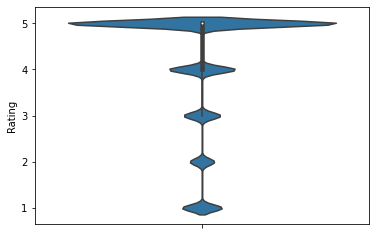

In [24]:
sns.violinplot(y = df.Rating)

<AxesSubplot:ylabel='Rating'>

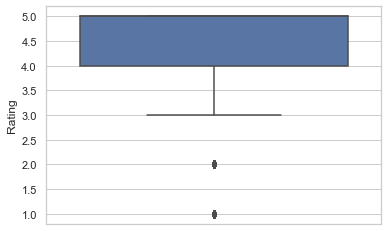

In [25]:
sns.set(style="whitegrid")
sns.boxplot(y = df['Rating'])

In [26]:
from sklearn import preprocessing

label_encoder = preprocessing.LabelEncoder()

#To convert alphanumeric data to numeric

In [27]:
dataset = df
dataset['user'] = label_encoder.fit_transform(df['UserId'])
dataset['product'] = label_encoder.fit_transform(df['ProductId'])
dataset.head()

,UserId,ProductId,Rating,Timestamp,user,product
0,A39HTATAQ9V7YF,0205616461,5.0,1369699200,725046,0
1,A3JM6GV9MNOF9X,0558925278,3.0,1355443200,814606,1
2,A1Z513UWSAAO0F,0558925278,5.0,1404691200,313101,1
3,A1WMRR494NWEWV,0733001998,4.0,1382572800,291075,2
4,A3IAAVS479H7M7,0737104473,1.0,1274227200,802842,3


In [28]:
# average rating given by each user
average_rating = dataset.groupby(by="user", as_index=False)['Rating'].mean()
print("Average rating given by users: \n",average_rating.head())
print("----------------------------------------------------------\n")


# let's merge it with the dataset as we will be using that later
dataset = pd.merge(dataset, average_rating, on="user")
print("Modified dataset: \n", dataset.head())
print("----------------------------------------------------------\n")

# renaming columns
dataset = dataset.rename(columns={"Rating_x": "real_rating", "Rating_y": "average_rating"})
print("Dataset: \n", dataset.head())
print("----------------------------------------------------------\n")

Average rating given by users: 
    user  Rating
0     0     5.0
1     1     5.0
2     2     3.0
3     3     5.0
4     4     5.0
----------------------------------------------------------

Modified dataset: 
            UserId   ProductId  Rating_x   Timestamp    user  product  Rating_y
0  A39HTATAQ9V7YF  0205616461       5.0  1369699200  725046        0      4.25
1  A39HTATAQ9V7YF  B002OVV7F0       3.0  1369699200  725046    81854      4.25
2  A39HTATAQ9V7YF  B0031IH5FQ       5.0  1369699200  725046    89013      4.25
3  A39HTATAQ9V7YF  B006GQPZ8E       4.0  1369699200  725046   154092      4.25
4  A3JM6GV9MNOF9X  0558925278       3.0  1355443200  814606        1      3.50
----------------------------------------------------------

Dataset: 
            UserId   ProductId  real_rating   Timestamp    user  product  \
0  A39HTATAQ9V7YF  0205616461          5.0  1369699200  725046        0   
1  A39HTATAQ9V7YF  B002OVV7F0          3.0  1369699200  725046    81854   
2  A39HTATAQ9V7YF  B0

Certain users tend to give higher ratings while others tend to give lower ratings. To negate this bias, we normalise the ratings given by the users.


In [29]:
dataset['normalized_rating'] = dataset['real_rating'] - dataset['average_rating']
print("Data with adjusted rating: \n", dataset.head())

Data with adjusted rating: 
            UserId   ProductId  real_rating   Timestamp    user  product  \
0  A39HTATAQ9V7YF  0205616461          5.0  1369699200  725046        0   
1  A39HTATAQ9V7YF  B002OVV7F0          3.0  1369699200  725046    81854   
2  A39HTATAQ9V7YF  B0031IH5FQ          5.0  1369699200  725046    89013   
3  A39HTATAQ9V7YF  B006GQPZ8E          4.0  1369699200  725046   154092   
4  A3JM6GV9MNOF9X  0558925278          3.0  1355443200  814606        1   

   average_rating  normalized_rating  
0            4.25               0.75  
1            4.25              -1.25  
2            4.25               0.75  
3            4.25              -0.25  
4            3.50              -0.50  


#User based Collaborative Filtering

#Cosine Similarity

We use a distance based metric - cosine similarity to identify similar users. It is important first, to remove products that have very low number of ratings.


In [30]:
#Filter based on number of ratings available

rating_of_product = dataset.groupby('product')['real_rating'].count() # apply groupby 
ratings_of_products_df = pd.DataFrame(rating_of_product)
print("Real ratings:\n",ratings_of_products_df.head()) # check for real rating for products

Real ratings:
          real_rating
product             
0                  1
1                  2
2                  1
3                  1
4                  1


In [31]:
filtered_ratings_per_product = ratings_of_products_df[ratings_of_products_df.real_rating >= 200]
print(filtered_ratings_per_product.head())
print(filtered_ratings_per_product.shape)

         real_rating
product             
704              558
719              377
754              288
834              412
843              313
(934, 1)


In [32]:
# build a list of products to keep
popular_products = filtered_ratings_per_product.index.tolist()
print("Popular product count which have ratings over average rating count: ",len(popular_products))
print("--------------------------------------------------------------------------------")

filtered_ratings_data = dataset[dataset["product"].isin(popular_products)]
print("Filtered rated product in the dataset: \n",filtered_ratings_data.head())
print("---------------------------------------------------------------------------------")

print("The size of dataset has changed from ", len(dataset), " to ", len(filtered_ratings_data))
print("---------------------------------------------------------------------------------")

Popular product count which have ratings over average rating count:  934
--------------------------------------------------------------------------------
Filtered rated product in the dataset: 
             UserId   ProductId  real_rating   Timestamp     user  product  \
1   A39HTATAQ9V7YF  B002OVV7F0          3.0  1369699200   725046    81854   
18   AKJHHD5VEH7VG  B0000UTUVU          5.0  1232323200  1073169     2237   
20   AKJHHD5VEH7VG  B000F8HWXU          5.0  1379721600  1073169    16510   
45   AKJHHD5VEH7VG  B001LF4I8I          4.0  1232841600  1073169    65074   
47   AKJHHD5VEH7VG  B001OMI93S          5.0  1236643200  1073169    67333   

    average_rating  normalized_rating  
1         4.250000          -1.250000  
18        4.222222           0.777778  
20        4.222222           0.777778  
45        4.222222          -0.222222  
47        4.222222           0.777778  
---------------------------------------------------------------------------------
The size of dataset 

In [33]:
similarity = pd.pivot_table(filtered_ratings_data,values='normalized_rating',index='UserId',columns='product')
similarity = similarity.fillna(0)
print("Updated Dataset: \n",similarity.head())

Updated Dataset: 
 product                704     719     754     834     843     858     861     \
UserId                                                                          
A0010876CNE3ILIM9HV0      0.0     0.0     0.0     0.0     0.0     0.0     0.0   
A0011102257KBXODKL24I     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
A00120381FL204MYH7G3B     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
A00126503SUWI86KZBMIN     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
A001573229XK5T8PI0OKA     0.0     0.0     0.0     0.0     0.0     0.0     0.0   

product                873     944     981     ...  241604  242018  242048  \
UserId                                         ...                           
A0010876CNE3ILIM9HV0      0.0     0.0     0.0  ...     0.0     0.0     0.0   
A0011102257KBXODKL24I     0.0     0.0     0.0  ...     0.0     0.0     0.0   
A00120381FL204MYH7G3B     0.0     0.0     0.0  ...     0.0     0.0     0.0   
A00126503SUWI86KZBMIN  

In [34]:
from sklearn.metrics.pairwise import cosine_similarity
import operator

In [35]:
selecting_users = list(similarity.index)
selecting_users = selecting_users[:100]
print("You can select users from the below list:\n",selecting_users)

You can select users from the below list:
 ['A0010876CNE3ILIM9HV0', 'A0011102257KBXODKL24I', 'A00120381FL204MYH7G3B', 'A00126503SUWI86KZBMIN', 'A001573229XK5T8PI0OKA', 'A00203203EBR4E6BIUOKF', 'A00222842T0ZYI86C9LHU', 'A00258542AL4VKETFLGIJ', 'A00259242VSCRZPGIWP0M', 'A00262022JQPXX5SXEVJR', 'A00275441WYR3489IKNAB', 'A00328401T70RFN4P1IT6', 'A00349462AOAVUUPEJNQZ', 'A00370223FX3K9TUF1QCL', 'A00407141VL6SB77B1GGG', 'A00414041RD0BXM6WK0GX', 'A00426443G4MEWS3K1XFA', 'A004511036AHSSV5O4SBY', 'A00454102SR84NOYTI0JS', 'A00463203QYS5I5X6MMXW', 'A00473363TJ8YSZ3YAGG9', 'A00491723IYKW5UI74AEX', 'A0058336347PC7BSR0UJC', 'A00612582Z6ZU2SDMRQ07', 'A00615442TZG6MHZXJOIZ', 'A00627983P6OGUFJ3IW8H', 'A006502622TE53S3J9W6H', 'A00656692CXO0VGF00V9I', 'A006680338J29DP17XALU', 'A00669491O55AKJ5QVH9L', 'A00679332RYOO5406ARSG', 'A00700212KB3K0MVESPIY', 'A0072717335KA6520NEMI', 'A0074075A8TZJIPLGZEK', 'A00773851NXKGCZRY43PG', 'A0078719IR14X3NNUG0F', 'A00802872RVW2KLY6DAL0', 'A008374338GH2TUB0S8KP', 'A0085249

In [36]:
def getting_top_5_similar_users(user_id, similarity_table, k=5):
    '''

    :param user_id: the user we want to recommend
    :param similarity_table: the user-item matrix
    :return: Similar users to the user_id.
    '''

    # create a dataframe of just the current user
    user = similarity_table[similarity_table.index == user_id]
    # and a dataframe of all other users
    other_users = similarity_table[similarity_table.index != user_id]
    # calculate cosine similarity between user and each other user
    similarities = cosine_similarity(user, other_users)[0].tolist()

    indices = other_users.index.tolist()
    index_similarity = dict(zip(indices, similarities))

    # sort by similarity
    index_similarity_sorted = sorted(index_similarity.items(), key=operator.itemgetter(1))
    index_similarity_sorted.reverse()

    # take users
    top_users_similarities = index_similarity_sorted[:k]
    users = []
    for user in top_users_similarities:
        users.append(user[0])

    return users

In [37]:
user_id = "A0010876CNE3ILIM9HV0"
similar_users = getting_top_5_similar_users(user_id, similarity)

In [38]:
print("Top 5 similar users for user_id:",user_id," are: ",similar_users)

Top 5 similar users for user_id: A0010876CNE3ILIM9HV0  are:  ['AXNF1BLDR4P47', 'ARTHT19OB79VZ', 'ARQ9I3Y0VPB6N', 'AOXEXSN7M9ENJ', 'AN0AO97264HP4']


SPLITTING THE DATA INTO TRAIN AND TEST

We are dividing the data into train and test by using 70% of the data for training and 30% for testing.

In [39]:
from sklearn.model_selection import train_test_split


In [40]:
train_data, test_data=train_test_split(df,test_size=0.3,random_state=0)

In [41]:
train_data

,UserId,ProductId,Rating,Timestamp,user,product
495973,A1BUETKLUZZXK4,B000ZOFUOC,5.0,1364947200,106294,41504
918203,A2LDUEDTKH3EQB,B002RZKFAQ,4.0,1346284800,510346,83575
809303,ATN6N69YK8IP,B0022077CK,5.0,1400976000,1154133,72834
1746964,A4LMOYHT1RO2D,B009O02ZFK,5.0,1401148800,931860,190997
1755930,A16ZK7M304R6LE,B009TBTKM0,5.0,1404950400,63320,192530
...,...,...,...,...,...,...
152315,A3IJSPHKMT6VWL,B0009OAIE0,1.0,1380153600,805139,10161
963395,A37GCEQOU4GS1F,B0030GFXOE,5.0,1315008000,706813,88540
117952,A19ZRYQPLOOJYN,B0006PJRYO,3.0,1377129600,89867,7991
1484405,A2VD1LNQ0I45ZZ,B0067JF88M,5.0,1354147200,599388,152020


In [42]:
test_data

,UserId,ProductId,Rating,Timestamp,user,product
723411,A23ZJBVZ4OLDJ,B001KNHM4I,3.0,1395360000,355990,63815
1472875,A3O52IDYQ4Z66H,B0062U1QC8,4.0,1383436800,854481,150801
2000120,A1PDYBT822BHNJ,B00I14O9C2,5.0,1398384000,226629,243509
2014061,A14F5W1N7CZDVW,B00JDTFBR6,5.0,1399248000,40448,247251
1076951,A2EPK0CT24CZHS,B003O3C06M,4.0,1379635200,451239,101835
...,...,...,...,...,...,...
1730772,A3QEUDVICP2XAE,B009ERIUNY,5.0,1361145600,874683,188675
1125642,A2FTNFB864K8WE,B003XUMQWO,2.0,1386288000,461127,106549
489305,A2FXEGF02SGSUR,B000Z4NFA8,5.0,1355356800,462114,40908
1272914,A9PBEQI5R0XDV,B004NHVTJW,4.0,1341100800,977056,123970


In [43]:
print("train data shape:",train_data.shape)


train data shape: (1416149, 6)


In [44]:
print("test data shape:",test_data.shape)

test data shape: (606921, 6)


POPULARITY RECOMMENDATION MODEL

In [45]:
#Count of user_id for each unique product as recommendation score 
train_data_grouped = train_data.groupby('ProductId').agg({'UserId': 'count'}).reset_index()
train_data_grouped.rename(columns = {'UserId': 'score'},inplace=True)
train_data_grouped.head(20)

,ProductId,score
0,0558925278,1
1,0733001998,1
2,0737104473,1
3,0762451459,1
4,130414089X,1
5,130414643X,2
6,1304146537,1
7,130414674X,1
8,1304168522,2
9,1304174778,2


In [46]:
#Sort the products on recommendation score 
train_data_sort = train_data_grouped.sort_values(['score', 'ProductId'], ascending = [0,1]) 
      
#Generate a recommendation rank based upon score 
train_data_sort['rank'] = train_data_sort['score'].rank(ascending=0, method='first') 
          
#Get the top 5 recommendations 
popularity_recommendations = train_data_sort.head(5) 
popularity_recommendations 

,ProductId,score,rank
58235,B001MA0QY2,5249,1.0
9343,B0009V1YR8,2006,2.0
97515,B0043OYFKU,1762,3.0
2115,B0000YUXI0,1512,4.0
92468,B003V265QW,1493,5.0


In [47]:
# Use popularity based recommender model to make predictions
def recommend(user_id):     
    user_recommendations = popularity_recommendations 
          
    #Add user_id column for which the recommendations are being generated 
    user_recommendations['userId'] = user_id 
      
    #Bring user_id column to the front 
    cols = user_recommendations.columns.tolist() 
    cols = cols[-1:] + cols[:-1] 
    user_recommendations = user_recommendations[cols] 
          
    return user_recommendations 

In [48]:
find_recom = [10,50,100,150,200]   # This list is user choice.
for i in find_recom:
    print("The list of recommendations for the userId: %d\n" %(i))
    print(recommend(i))    
    print("\n") 

The list of recommendations for the userId: 10

       userId   ProductId  score  rank
58235      10  B001MA0QY2   5249   1.0
9343       10  B0009V1YR8   2006   2.0
97515      10  B0043OYFKU   1762   3.0
2115       10  B0000YUXI0   1512   4.0
92468      10  B003V265QW   1493   5.0


The list of recommendations for the userId: 50

       userId   ProductId  score  rank
58235      50  B001MA0QY2   5249   1.0
9343       50  B0009V1YR8   2006   2.0
97515      50  B0043OYFKU   1762   3.0
2115       50  B0000YUXI0   1512   4.0
92468      50  B003V265QW   1493   5.0


The list of recommendations for the userId: 100

       userId   ProductId  score  rank
58235     100  B001MA0QY2   5249   1.0
9343      100  B0009V1YR8   2006   2.0
97515     100  B0043OYFKU   1762   3.0
2115      100  B0000YUXI0   1512   4.0
92468     100  B003V265QW   1493   5.0


The list of recommendations for the userId: 150

       userId   ProductId  score  rank
58235     150  B001MA0QY2   5249   1.0
9343      150  B0009

/var/folders/2c/bn4tv1y10ws_q6rw6r_rg5jr0000gn/T/ipykernel_61977/1458617337.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/2c/bn4tv1y10ws_q6rw6r_rg5jr0000gn/T/ipykernel_61977/1458617337.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/2c/bn4tv1y10ws_q6rw6r_rg5jr0000gn/T/ipykernel_61977/1458617337.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the d

we can all the users are given the same recommondation. From this we can see this is not an personalized recommendation model


Collaborative Filtering Model

In [49]:
df_CF = pd.concat([train_data, test_data]).reset_index()
df_CF.head()

,index,UserId,ProductId,Rating,Timestamp,user,product
0,495973,A1BUETKLUZZXK4,B000ZOFUOC,5.0,1364947200,106294,41504
1,918203,A2LDUEDTKH3EQB,B002RZKFAQ,4.0,1346284800,510346,83575
2,809303,ATN6N69YK8IP,B0022077CK,5.0,1400976000,1154133,72834
3,1746964,A4LMOYHT1RO2D,B009O02ZFK,5.0,1401148800,931860,190997
4,1755930,A16ZK7M304R6LE,B009TBTKM0,5.0,1404950400,63320,192530


we are doing collaberative filtering based on user with productid

In [50]:
for column in df_CF:
    if df_CF[column].dtype == 'float64':
        df_CF[column]=pd.to_numeric(df_CF[column], downcast='float')
    if df_CF[column].dtype == 'int64':
        df_CF[column]=pd.to_numeric(df_CF[column], downcast='integer')

In [51]:
# Collaborative Filtering Model
from sklearn import preprocessing

label_encoder = preprocessing.LabelEncoder()